# Hate Speech and Offensive Language Detection



## About this dataset
This dataset, named hate_speech_offensive, is a meticulously curated collection of annotated tweets with the specific purpose of detecting hate speech and offensive language. The dataset primarily consists of English tweets and is designed to train machine learning models or algorithms in the task of hate speech detection. It should be noted that the dataset has not been divided into multiple subsets, and only the train split is currently available for use.

The dataset includes several columns that provide valuable information for understanding each tweet's classification. The column count represents the total number of annotations provided for each tweet, whereas hate_speech_count signifies how many annotations classified a particular tweet as hate speech. On the other hand, offensive_language_count indicates the number of annotations categorizing a tweet as containing offensive language. Additionally, neither_count denotes how many annotations identified a tweet as neither hate speech nor offensive language.

For researchers and developers aiming to create effective models or algorithms capable of detecting hate speech and offensive language on Twitter, this comprehensive dataset offers a rich resource for training and evaluation purposes.

Data Source; https://huggingface.co/datasets/hate_speech_offensive

In [1]:
# nlp
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.stem import PorterStemmer
import re
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from nltk.tokenize import regexp_tokenize, TweetTokenizer, word_tokenize, sent_tokenize


# miscellaneous
import matplotlib.pyplot as plt
from glob import glob #library that helps us search for files
import scipy
import random
from datetime import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
from scipy.special import inv_boxcox

# preprocessing
from category_encoders import OneHotEncoder,TargetEncoder,OrdinalEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import PolynomialFeatures
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, IterativeImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer, PowerTransformer,LabelEncoder, MaxAbsScaler, RobustScaler
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV
from sklearn.model_selection import cross_val_score,cross_val_predict, KFold, StratifiedKFold
from sklearn.compose import ColumnTransformer

# models
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression,BayesianRidge, ElasticNet, Lasso
from sklearn.dummy import DummyClassifier
import xgboost as xgb
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier, GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier, VotingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.base import clone
from sklearn.naive_bayes import MultinomialNB

# metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score
from sklearn.metrics import log_loss, confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.utils.validation import check_is_fitted

# feature selection / data sampling
from sklearn.feature_selection import RFE, SelectKBest, f_classif, SelectFromModel, VarianceThreshold
from imblearn.over_sampling import SMOTE, ADASYN
from sklearn.neighbors import KNeighborsClassifier
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from sklearn.inspection import permutation_importance

#saving model
import pickle
import joblib

# data settings
pd.pandas.set_option('display.max_rows',None)
pd.pandas.set_option('display.max_columns',None)
pd.set_option('display.max_colwidth', None)


from sklearn import set_config
set_config(transform_output = 'pandas')

import warnings
warnings.simplefilter(action="ignore")

In [2]:
path = "C:/Users/Oamen/OneDrive/Documents/DATA PROJECTS/Project_Offensive_Hate_Speech_Detection/train.csv"

In [3]:
df = pd.read_csv(path)

print(df.shape)

(24783, 6)


## Decode Target

In [4]:
df['class'] = df['class'].replace({
    0:'hate_speech',
    1:'offensive_language',
    2:'Neutral'
})

df[:3]

,count,hate_speech_count,offensive_language_count,neither_count,class,tweet
0,3,0,0,3,Neutral,!!! RT @mayasolovely: As a woman you shouldn't complain about cleaning up your house. &amp; as a man you should always take the trash out...
1,3,0,3,0,offensive_language,!!!!! RT @mleew17: boy dats cold...tyga dwn bad for cuffin dat hoe in the 1st place!!
2,3,0,3,0,offensive_language,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby4life: You ever fuck a bitch and she start to cry? You be confused as shit


## Convert to binary target

In [5]:
df['class'] = np.where(df['class'] == 'hate_speech', 'hate_or_offensive', np.where(df['class'] == 'offensive_language', 'hate_or_offensive', df['class']))

## Pick Important features

In [6]:
df = df[['tweet', 'class']]

## Split Data

In [7]:
train_full, test = train_test_split(df, test_size = 0.2, random_state = 90)

train, validation = train_test_split(train_full, test_size = 0.25, random_state = 90)

[x.shape for x in [train, test, validation]]

[(14869, 2), (4957, 2), (4957, 2)]

## Data Exploration

In [8]:
df = train.copy()

## Distribution of Target

In [9]:
target = 'class'

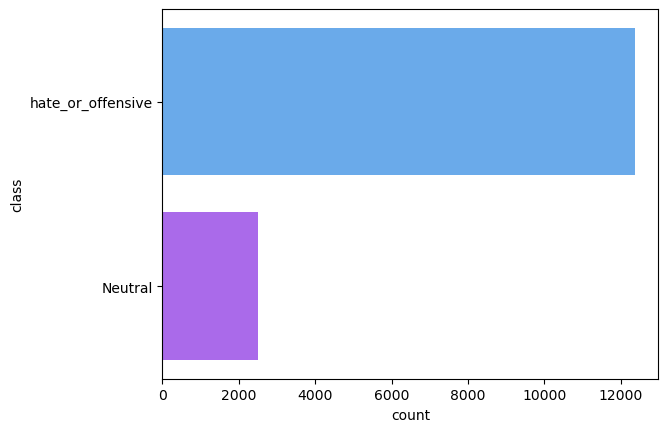

In [10]:
sns.countplot(data = df, y = target, palette = 'cool');

## Model building

In [11]:
models = []

models.append( ('nb',MultinomialNB() ) )
#models.append( ('tree',DecisionTreeClassifier() ) )
#models.append( ('logreg',LogisticRegression() ) )
#models.append( ('forest',RandomForestClassifier() ) )
#models.append( ('adaboost',AdaBoostClassifier() ) )
#models.append( ('knn',KNeighborsClassifier() ) )
#models.append( ('xgboost',xgb.XGBClassifier() ) )

In [12]:
def evaluate(xtrain, ytrain, experiment_number):
    
    names, accuracy, precision, recall, f1, auc = [], [], [], [], [], []
    
    for name, model in models:
        
        names.append(name)
        
        accuracy.append(cross_val_score(model, xtrain, ytrain, cv = 3, scoring = 'accuracy').mean())
                
        precision.append(cross_val_score(model, xtrain, ytrain, cv = 3, scoring = 'precision').mean())
         
        recall.append(cross_val_score(model, xtrain, ytrain, cv = 3, scoring = 'recall').mean())     
 
        f1.append(cross_val_score(model, xtrain, ytrain, cv = 3, scoring = 'f1').mean())
        
        auc_ = cross_val_score(model, xtrain, ytrain, cv = 3, scoring = 'roc_auc').mean()
        auc.append(auc_)
        
        ypred_proba = cross_val_predict(model, xtrain, ytrain, cv = 3, method = 'predict_proba')
        
        print(ypred_proba)
        
        fpr, tpr, thresh = roc_curve(ytrain, ypred_proba[:, 1])
        
        plt.plot(fpr, tpr, label = f'{name}: {auc_}');plt.xlabel('FPR'); plt.ylabel('TPR'); plt.legend();plt.show();
        
        ypred_class = cross_val_predict(model, xtrain, ytrain, cv = 3)
        cm = confusion_matrix(ytrain, ypred_class)
        ConfusionMatrixDisplay(cm).plot(); plt.show();
        
        print(classification_report(ytrain, ypred_class))
        
    metrics =  pd.DataFrame({
            'names':names,
            'accuracy':accuracy,
            'precision':precision,
            'recall':recall,
            'f1':f1,
            'auc':auc,
        })
    
    metrics.index = [f'{name}_{experiment_number}' for name in metrics['names']]
    metrics.drop(['names'], axis = 1, inplace = True)
    
    return metrics

## Split data

In [13]:
ytrain = train['class']
ytest = test['class']
yval = validation['class']

## Encode Target

In [14]:
mapping = {'hate_or_offensive':1, 'Neutral':0}

ytrain = ytrain.replace(mapping)

ytest = ytest.replace(mapping)

yval = yval.replace(mapping)

## PREPROCESSING - EXPERIMENT 0

- Resampling: None
- Cleaning: Remove punctuations, urls, @user etc
- Tokenizer: word_tokenize
- Vectorizer: CountVectorizer (unigram, remove stopwords)
- Lemmatizer or Stemming: None

In [62]:
xtrain_0, ytrain_0 = train['tweet'].copy(), ytrain.copy()

In [15]:
def placeholder_tokenize(text):
    
    text = text.lower()
    
    # replace all links with url
    text = re.sub(r"http[s]?://[\w\/\-\.\?]+", 'url', text)
    
    # replace hastags with the word after the hastag
    text = re.sub(r'#(\w+)', r'\1', text)
    
    # replace digits with numbers
    text = re.sub(r'\d+', 'num', text) 
    
    # replace punctuations
    punctuation_pattern = r'[!\"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~]'
    
    text = re.sub(punctuation_pattern, '', text)
    
    # replace @user with username
    text = re.sub(r'@\w+', 'username', text)
    

    # return words
    text = ' '.join([x for x in re.findall(r'\w+\s+', text)])
    
    return text

In [64]:
xtrains = pd.Series([placeholder_tokenize(text) for text in train['tweet']])
xtrains[:2]

0                                                                 rt  thats  yo  bitch  she  my  bitch 
1    username  username  you  guys  t  get  evolution  do  you  only  share  a  common  ancestor  with 
dtype: object

In [65]:
vectorizer = CountVectorizer(tokenizer = word_tokenize, stop_words = 'english')

In [66]:
pipeline_0 = Pipeline([
   ('vectorizer', vectorizer)
])

In [67]:
x = pipeline_0.fit_transform(xtrains)
x

<14869x12464 sparse matrix of type '<class 'numpy.int64'>'
	with 93766 stored elements in Compressed Sparse Row format>

In [68]:
xtrain_0 = pd.DataFrame(x.todense(), columns = pipeline_0.named_steps['vectorizer'].get_feature_names_out())
print(xtrain_0.shape)

(14869, 12464)


[[1.29015423e-07 9.99999871e-01]
 [2.32169558e-01 7.67830442e-01]
 [3.09321790e-02 9.69067821e-01]
 ...
 [2.66944404e-01 7.33055596e-01]
 [3.95332425e-03 9.96046676e-01]
 [3.93747849e-04 9.99606252e-01]]


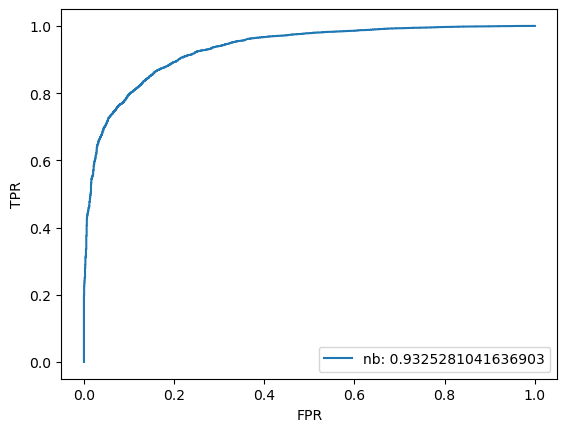

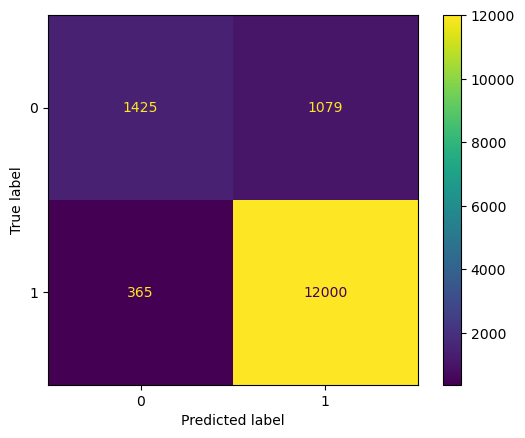

              precision    recall  f1-score   support

           0       0.80      0.57      0.66      2504
           1       0.92      0.97      0.94     12365

    accuracy                           0.90     14869
   macro avg       0.86      0.77      0.80     14869
weighted avg       0.90      0.90      0.90     14869

[[0. 1.]
 [0. 1.]
 [1. 0.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]


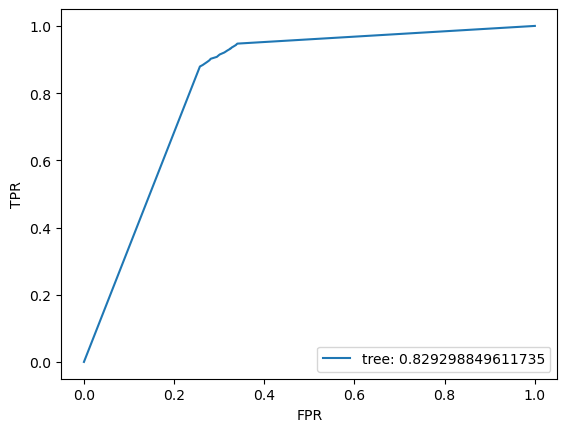

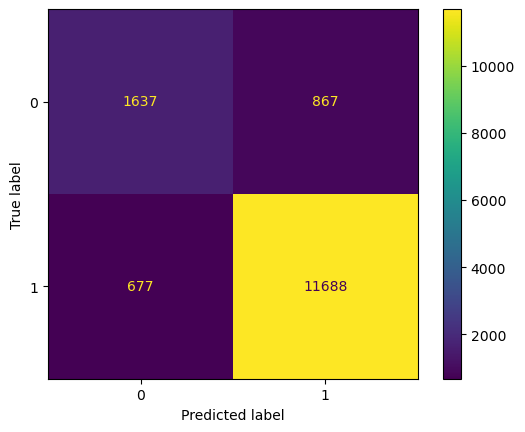

              precision    recall  f1-score   support

           0       0.71      0.65      0.68      2504
           1       0.93      0.95      0.94     12365

    accuracy                           0.90     14869
   macro avg       0.82      0.80      0.81     14869
weighted avg       0.89      0.90      0.89     14869

[[3.79874349e-05 9.99962013e-01]
 [2.08585391e-01 7.91414609e-01]
 [3.43706730e-01 6.56293270e-01]
 ...
 [2.53975140e-01 7.46024860e-01]
 [3.17528374e-01 6.82471626e-01]
 [6.50651878e-03 9.93493481e-01]]


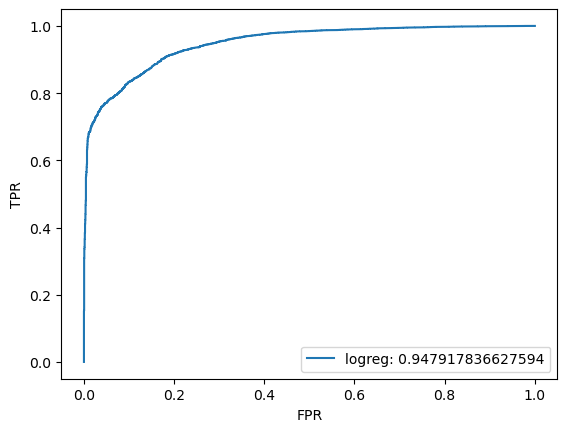

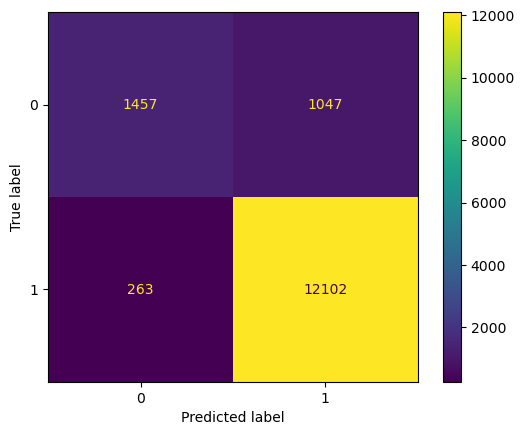

              precision    recall  f1-score   support

           0       0.85      0.58      0.69      2504
           1       0.92      0.98      0.95     12365

    accuracy                           0.91     14869
   macro avg       0.88      0.78      0.82     14869
weighted avg       0.91      0.91      0.91     14869

[[0.         1.        ]
 [0.07969331 0.92030669]
 [0.1        0.9       ]
 ...
 [0.02       0.98      ]
 [0.11       0.89      ]
 [0.         1.        ]]


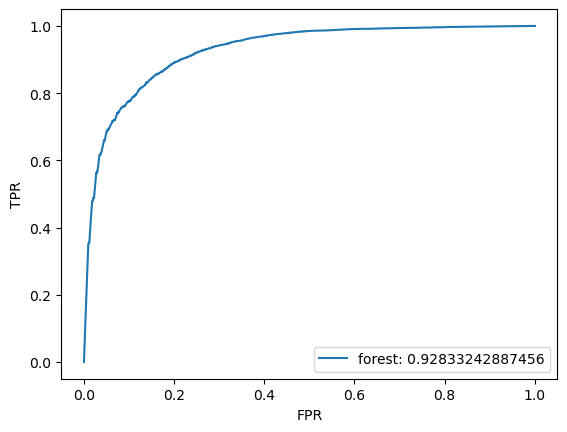

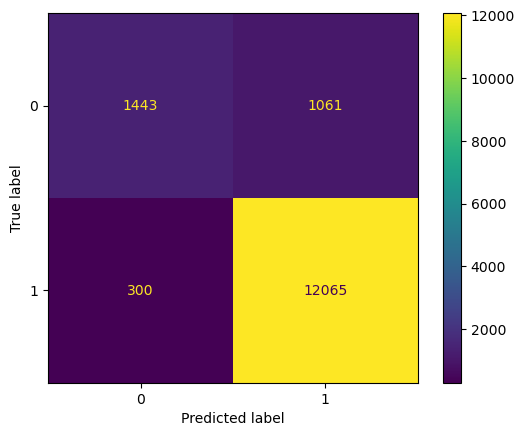

              precision    recall  f1-score   support

           0       0.83      0.58      0.68      2504
           1       0.92      0.98      0.95     12365

    accuracy                           0.91     14869
   macro avg       0.87      0.78      0.81     14869
weighted avg       0.90      0.91      0.90     14869

[[0.45765481 0.54234519]
 [0.49539964 0.50460036]
 [0.49539964 0.50460036]
 ...
 [0.49498284 0.50501716]
 [0.49498284 0.50501716]
 [0.47420893 0.52579107]]


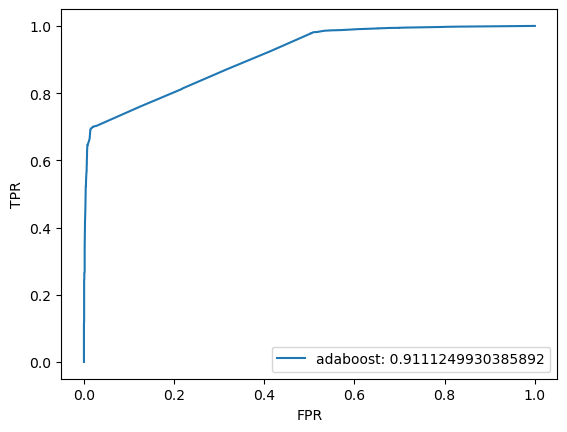

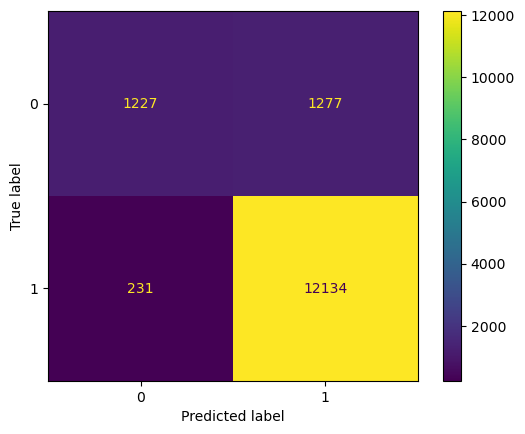

              precision    recall  f1-score   support

           0       0.84      0.49      0.62      2504
           1       0.90      0.98      0.94     12365

    accuracy                           0.90     14869
   macro avg       0.87      0.74      0.78     14869
weighted avg       0.89      0.90      0.89     14869

[[0. 1.]
 [0. 1.]
 [0. 1.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]


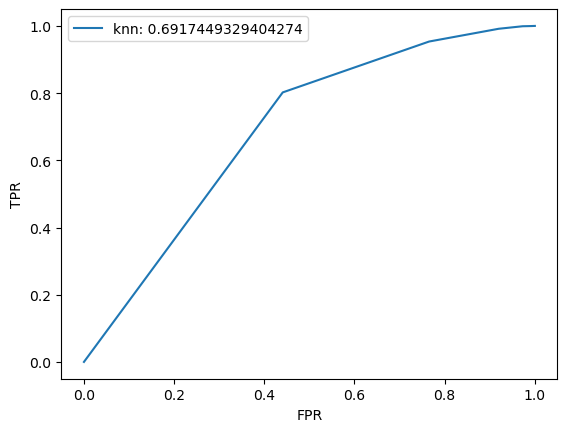

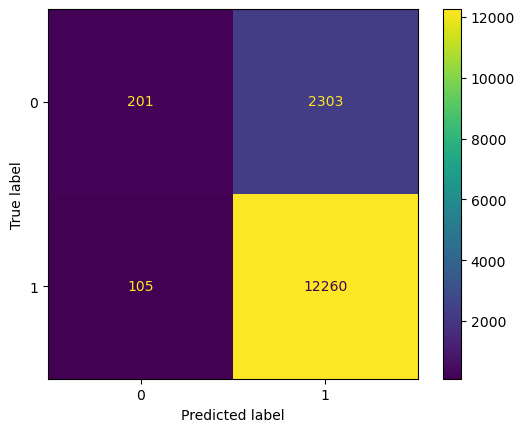

              precision    recall  f1-score   support

           0       0.66      0.08      0.14      2504
           1       0.84      0.99      0.91     12365

    accuracy                           0.84     14869
   macro avg       0.75      0.54      0.53     14869
weighted avg       0.81      0.84      0.78     14869

[[0.00350648 0.9964935 ]
 [0.238532   0.761468  ]
 [0.2519542  0.7480458 ]
 ...
 [0.2533378  0.7466622 ]
 [0.27656835 0.72343165]
 [0.01100314 0.98899686]]


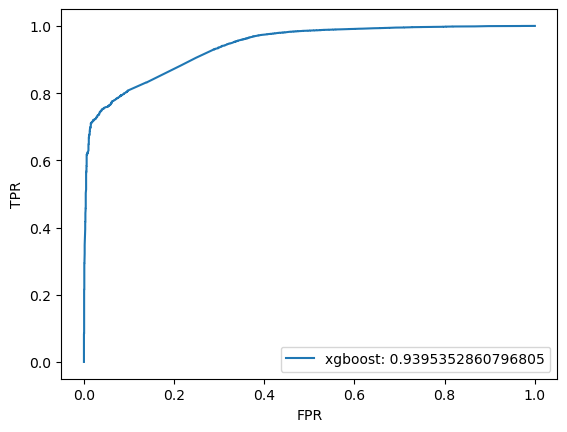

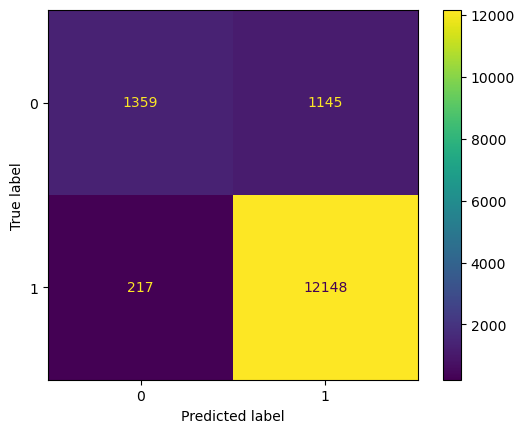

              precision    recall  f1-score   support

           0       0.86      0.54      0.67      2504
           1       0.91      0.98      0.95     12365

    accuracy                           0.91     14869
   macro avg       0.89      0.76      0.81     14869
weighted avg       0.91      0.91      0.90     14869



In [69]:
metrics_0 = evaluate(xtrain_0, ytrain_0, 0)

In [80]:
metrics_0

,accuracy,precision,recall,f1,auc
nb_0,0.902885,0.917509,0.970481,0.943250,0.932528
tree_0,0.896833,0.932209,0.944925,0.938337,0.829299
logreg_0,0.911898,0.920387,0.978730,0.948659,0.947918
forest_0,0.907526,0.918959,0.975657,0.946652,0.928332
adaboost_0,0.898648,0.904787,0.981399,0.941538,0.911125
knn_0,0.838052,0.841867,0.991508,0.910574,0.691745
xgboost_0,0.908400,0.913874,0.982450,0.946920,0.939535


## PREPROCESSING - EXPERIMENT 1

- Resampling: UnderSampler
- Cleaning: Remove punctuations, urls, @user etc
- Tokenizer: sent_tokenize 
- Vectorizer: CountVectorizer (bigram, remove stopwords)
- Lemmatizer or Stemming: WordNetLemmatizer

In [16]:
xtrain_1, ytrain_1 = RandomUnderSampler().fit_resample(train['tweet'].values.reshape(-1, 1), ytrain)

xtrain_1 = pd.DataFrame(xtrain_1, columns = ['tweet'])
xtrain_1[:2]

,tweet
0,@smokeabluntdgaf @Haiimbreanna You guys don't get evolution do you? You only share a common ancestor with apes.
1,@emilysteers WASP EGGS


In [15]:
def placeholder_tokenize(text):
    
    text = text.lower()
    
    # replace all links with url
    text = re.sub(r"http[s]?://[\w\/\-\.\?]+", 'url', text)
    
    # replace hastags with the word after the hastag
    text = re.sub(r'#(\w+)', r'\1', text)
    
    # replace digits with numbers
    text = re.sub(r'\d+', 'num', text) 
    
    # replace punctuations
    punctuation_pattern = r'[!\"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~]'
    
    text = re.sub(punctuation_pattern, '', text)
    
    # replace @user with username
    text = re.sub(r'@\w+', 'username', text)
    

    # return words
    text = ' '.join([x for x in re.findall(r'\w+\s+', text)])
    
    return text

In [18]:

xtrains = pd.Series([placeholder_tokenize(text) for text in xtrain_1['tweet']])
xtrains[:2]

0    username  username  you  guys  t  get  evolution  do  you  only  share  a  common  ancestor  with 
1                                                                                       username  wasp 
dtype: object

In [19]:
vectorizer = CountVectorizer(stop_words = 'english', ngram_range = (2,2))

# lemmatizer = WordNetLemmatizer()
# func_lemmatizer = FunctionTransformer(lemmatizer)

In [20]:
def lemmatize(text):
    
    lemmatizer = WordNetLemmatizer()
    
    return ' '.join([lemmatizer.lemmatize(word) for word in text.split()])

xtrains = pd.Series([lemmatize(text) for text in xtrains])
xtrains[:4]

0                    username username you guy t get evolution do you only share a common ancestor with
1                                                                                         username wasp
2    username t feel like reading right now i wanna give a sexy coolie girl some lyric via text message
3                                                       i am a thrill with a hillbilly hahahahaha jesus
dtype: object

In [21]:
pipeline_1 = Pipeline([
    #('lemmatizer',func_lemmatizer),
    ('vectorizer',vectorizer)
])

In [22]:
x = pipeline_1.fit_transform(xtrains)

In [23]:
xtrain_1 = pd.DataFrame(x.todense(), columns = pipeline_1.named_steps['vectorizer'].get_feature_names_out())
xtrain_1.sample(2)

,_____ showing,aa blink,aa miw,aan stok,aaron hernandez,abandonado en,abc right,abdelka te,abduction linked,abdurahman al,aberdeen just,ability bring,ability function,able eat,abortion ban,abouttime hard,abraham lincoln,absolute said,absolute scared,absolute sewage,absolutely absurd,absolutely amazing,absolutely just,absolutely knew,absolutely love,absolutely work,absurd cause,absurd think,abt poor,abu abdurahman,abu statement,abundance bird,abused wife,abusive holic,aca cost,aca gop,accent come,accept al,accept fact,accept just,accept texas,acceptable academic,access mexican,accidentally ate,accnt continues,accompanied rope,according data,according espn,according place,account british,account omg,account unpleasant,acct info,accused spy,accused taking,aceptar este,aceves relieve,ach websingle,acknowledge gonna,acknowledging hairy,acne pull,acoustic dome,acquire chase,acquire lebron,act defiance,act fgcu,act gay,act hollywood,act just,act like,act nice,act poor,act right,actin awfully,actin like,acting iffy,acting like,acting num,acting outta,action thank,action topic,action whamm,active website,activist judge,actor charlie,actor given,actual just,actual loyal,actual tweet,actually bitch,actually going,actually hate,actually hoe,actually holding,actually mets,actually nf,actually seen,actually start,actually surprised,actually used,actually work,actually yellow,ad gun,ad haitian,adam sandler,add ghetto,add mo,add robin,add turn,adept cum,administrator son,admins hungry,admit best,admits beating,admits fox,adorable crochet,adorable cute,adtr bmth,adtr ptv,adult decision,adult human,adult know,advance thee,advanced groupofdeath,advanced url,adventure need,advertised ny,advice tip,advised slant,ae yous,aerin told,aeros transplanted,aerosolized virus,af boyfriend,af career,af cause,af did,af end,af lol,af thats,af time,afc jag,afc wa,affleck refusing,afford buy,afford date,afford winter,afi pe,african bitch,ag ugly,age like,ago rb,ago url,agree fucked,ah ah,ah bitch,ah bitter,ah fitting,ah lie,ah lil,ah man,ah mintue,ah need,ah nigga,ah yardie,aha hoe,ahah chill,ahead tell,ahh bitch,ahha remember,ahhhhh tried,ahl attendance,ahora ganarle,ahora snuggle,aid border,aid infected,aid single,aid wa,aid worker,aide sooo,aight hoe,aim dream,aim faster,ainn complete,aint animated,aint bitch,aint cheap,aint cute,aint doe,aint east,aint everybody,aint fuckin,aint fucking,aint funny,aint good,aint got,aint hoe,aint jealous,aint jungle,aint lawyer,aint like,aint look,aint loyal,aint lung,aint nuffin,aint nun,aint nuttin,aint pussy,aint shit,aint thats,aint worried,aint yo,air abc,air clip,air time,ajmi arrested,ajumma walk,aka charlie,aka chart,aka month,aka pussy,aka trash,aknum taking,al britani,al furqan,al goreing,al green,al hardcore,al haymon,al icebucketchallenge,al jaren,al market,al memorabilia,al niet,al qaeda,al red,al ride,alabama overrated,alabamian kid,alarm early,albino albino,albino astigmatism,albino deer,albino fish,albino named,albino red,albino sea,albino tho,album rt,album theperfectanswer,album wa,alchohol claim,alcohol bought,alcoholism mildly,alcoholism washingtondc,alec baldwin,alex ramos,alex rodriguez,alex smith,alexandra earring,alfie right,alfredo aceves,algebra num,alien demon,alien url,alike cause,alive kasur,alive knight,alive night,allah kiss,alledged kidnapping,allen goddamn,allen west,allezwiggo just,allied soldier,alligator face,allowed cute,allowed girl,allowed live,allowed play,allowed utampa,allowed wallet,allowin numplay,allstar weekend,almond coconut,aloha muzzie,alongside lech,alot female,alot fucking,alot people,alpha just,alright like,alright nah,alright seriously,alright time,alsina doin,alsina im,althea want,altyd zo,alu polosi,aluminum trash,alves new,alway username,alweer met,alyssa ignoring,amar singh,amas emabiggestfansnumd,amazing deliciously,amber posh,amber rose,amber warning,amen num,amendment banning,amendment num,america ha,america url,america white,american bald,american claim,american c

In [ ]:
metrics_1 = evaluate(xtrain_1, ytrain_1, 1)

In [170]:
# save metrics

metrics_0_1 = pd.concat([metrics_0, metrics_1])
metrics_0_1.to_csv("C:/Users/Oamen/OneDrive/Documents/DATA PROJECTS/Project_Offensive_Hate_Speech_Detection/metrics_0_1.csv")

## PREPROCESSING - EXPERIMENT 2

- Resampling: OverSampler
- Tokenizer: Tweet_tokenize 
- Cleaning: Remove punctuations, urls, @user etc
- Vectorizer: CountVectorizer (ngram(1,3, remove stopwords)
- Lemmatizer or Stemming: PorterStemmer

In [16]:
xtrain_2, ytrain_2 = RandomOverSampler().fit_resample(train['tweet'].values.reshape(-1, 1), ytrain)

xtrain_2 = pd.DataFrame(xtrain_2, columns = ['tweet'])
xtrain_2[:2]

,tweet
0,RT @YoungDG_: Thats yo bitch she my bitch too
1,@smokeabluntdgaf @Haiimbreanna You guys don't get evolution do you? You only share a common ancestor with apes.


In [17]:
xtrain_2 = pd.DataFrame([placeholder_tokenize(text) for text in xtrain_2['tweet']], columns = ['tweet'])

In [18]:
def stemm(text):
    
    stemmer = PorterStemmer()
    
    return ' '.join([stemmer.stem(word) for word in text.split()])

In [19]:
xtrains = pd.DataFrame([stemm(text) for text in xtrain_2['tweet']], columns = ['tweet'])
xtrains.sample(2)

,tweet
22361,be coon all are
12075,instead of join sport hoe be join twerk


In [20]:
#stemmer = PorterStemmer()

vectorizer = CountVectorizer(ngram_range = (2,3), stop_words = 'english')

In [21]:
#sent_tokenize()

In [22]:
pipeline_2 = Pipeline([
   # ('stemmer',stemmer),
    ('vectorizer', vectorizer)
])

In [23]:
x = pipeline_2.fit_transform(xtrains['tweet'])

In [24]:
xtrain_2 = pd.DataFrame(x.todense(), columns = pipeline_2.named_steps['vectorizer'].get_feature_names_out())
xtrain_2[:2]

,__ cool,__ cool son,___ insert,___ insert old,____ bitch,____ bitch ass,_____ bitch,_____ bitch kill,_____ man,_____ man fuck,aa blink,aa blink num,aa class,aa class bc,aa miw,aa miw btf,aan stok,aan stok na,aap congi,aap congi delusion,aaron girlfriend,aaron girlfriend lie,aaron hernandez,aaron hernandez went,aaron weak,aaryn num,aaryn num bitch,ab pussi,ab start,ab start stroke,abandonado en,abc right,abc right great,abdelka te,abdelka te min,abduct link,abduct link british,abdurahman al,abdurahman al britani,aberdeen just,aberdeen just won,abil bring,abil bring bird,abil calm,abil calm slap,abil function,abil function choos,abl bitch,abl bitch feet,abl cuddl,abl cuddl right,abl cut,abl cut hair,abl eat,abl eat bird,abl make,abl make tight,abl sneak,abl sneak quick,abort babi,abort babi abort,abort ban,abort ban pass,abort bitch,abort bitch soon,abort got,abort got cemeteri,abouttim hard,abouttim hard ass,abov influenc,abov influenc guy,abov said,abov said aint,abov whichisit,abraham lincoln,abraham lincoln coolest,abraham thi,abraham thi quot,absolut absurd,absolut absurd think,absolut agre,absolut agre just,absolut amaz,absolut amaz delici,absolut becaus,absolut becaus scare,absolut bitch,absolut just,absolut just nonsens,absolut love,absolut love shanti,absolut nobodi,absolut nobodi knew,absolut said,absolut said slipperi,absolut sewag,absolut support,absolut support republican,absolut work,absolut worst,absolut worst paper,abstract thinker,absurd caus,absurd caus battl,absurd think,absurd think joke,abt control,abt control state,abt junior,abt junior public,abt poor,abt poor product,abu abdurahman,abu abdurahman al,abu statement,abu statement hi,abund bird,abund bird nyc,abus bf,abus hi,abus hi wife,abus holic,abus holic just,ac insur,aca cost,aca cost cover,aca gop,aca gop gov,acceler warholian,acceler warholian notion,accent come,accent come famili,accent shi,accent shi hell,accept academ,accept al,accept al icebucketchalleng,accept bad,accept bad bitch,accept beat,accept beat bitch,accept fact,accept fact hoe,accept girl,accept girl look,accept im,accept im wa,accept just,accept know,accept know bitch,accept num,accept num polit,accept sexual,accept sexual advanc,accept texa,accept texa accord,access mexican,access mexican twinki,accessori dea,accident ate,accident ate firefli,accident fat,accident fat black,accnt continu,accnt continu trash,accompani rope,accompani rope right,accord espn,accord espn media,accord place,accord place excus,accord thi,accord thi data,account british,account dumb,account dumb bitch,account incred,account leav,account leav alon,account omg,account omg imma,account stop,account think,account think wow,account ugli,account unpleas,account unpleas fact,acct info,acct info trash,accuraci rt,accuraci rt henni,accus adulteri,accus adulteri skyrocket,accus face,accus face slant,accus spi,accus spi url,accustom nigger,accustom nigger muchyour,ace boon,ace boon usernam,ace hoe,ace hoe soo,ace ventura,aceptar est,aceptar est luz,acev reliev,acev reliev usernam,ach ur,ach ur follow,ach websingl,ach websingl xxxxxnum,ackin like,ackin like shock,acknowledg ex,acknowledg gonna,acknowledg gonna happen,acknowledg veri,acknowledg veri hairi,acl mtv,acn pull,acn pull hotter,acoust dome,acoust dome favorit,acoust justin,acoust justin bieber,acquir chase,acquir chase headley,acquir lebron,acquir lebron jame,act act,act act like,act bitch,act bitch slop,act black,act black speak,act bold,act bold somebodi,act buuut,act childish,act crazi,act crazi dont,act deal,act deal wit,act defianc,act dumb,act dumb tryna,act fgcu,act gay,act gay today,act ghetto,act ghetto caus,act hard,act hard bad,act hard haha,act hard realli,act hard stay,act hollywood,act hollywood round,act iffi,act just,act just chief,act know,act know imma,act like,act like age,act like aint,act like babi,act like bitch,act like bitchi,act like break,act like bron,act like bunch,act like camera,act like care,act like casper,act like complet,act l

[[2.67539056e-05 9.99973246e-01]
 [1.00000000e+00 3.07407791e-10]
 [5.60153414e-01 4.39846586e-01]
 ...
 [9.99994704e-01 5.29639520e-06]
 [9.99999938e-01 6.19231877e-08]
 [1.00000000e+00 3.07446690e-13]]


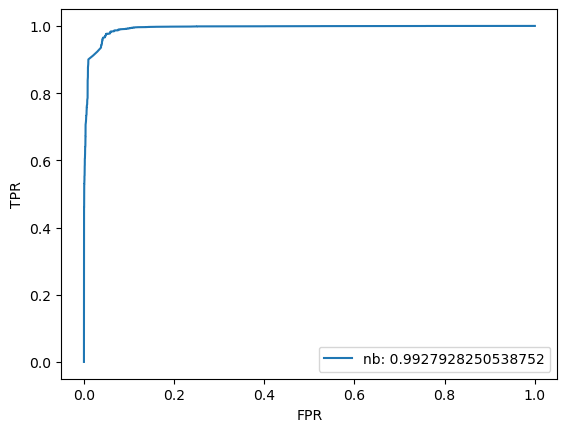

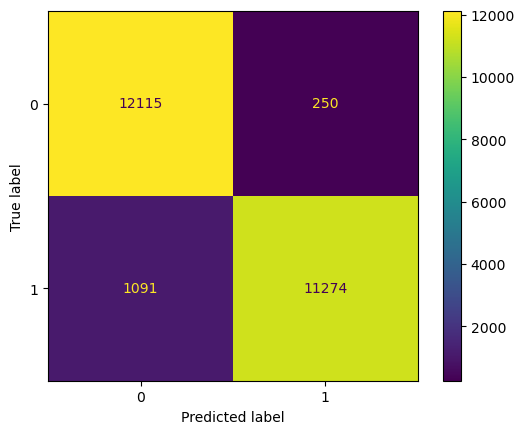

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12365
           1       0.98      0.91      0.94     12365

    accuracy                           0.95     24730
   macro avg       0.95      0.95      0.95     24730
weighted avg       0.95      0.95      0.95     24730



In [25]:
metrics_2 = evaluate(xtrain_2, ytrain_2, 2)

In [26]:
xtrain_2.shape

(24730, 117007)

## PREPROCESSING - EXPERIMENT 3

- Resampling: ADASYN
- Tokenizer: custom 
- Cleaning: Remove punctuations, urls, @user etc
- Vectorizer: Tfidf (min_df = 3, remove stopwords)
- Lemmatizer or Stemming: WordNEtLemmatizer

In [81]:
xtrain_3, ytrain_3 = train[['tweet']].copy(), ytrain.copy()

In [82]:
xtrain_3 = pd.DataFrame([placeholder_tokenize(row) for row in xtrain_3['tweet']], columns = ['tweet'])
xtrain_3[:2]

,tweet
0,rt thats yo bitch she my bitch
1,username username you guys t get evolution do you only share a common ancestor with


In [83]:
#stemmer = PorterStemmer()

vectorizer = TfidfVectorizer(stop_words = 'english')

In [84]:
def stemm_(text):
    
    stemmer = PorterStemmer()
    
    value = ''.join([stemmer.stem(word) for word in text])
    
    return value  

In [85]:
xtrain_3 = pd.DataFrame([stemm_(text) for text in xtrain_3['tweet']], columns = ['tweet'])
xtrain_3[:1]

,tweet
0,rt thats yo bitch she my bitch


In [86]:
pipeline_3 = Pipeline([
   # ('stemmer',stemmer),
    ('vectorizer', vectorizer)
])

In [87]:
x = pipeline_3.fit_transform(xtrain_3['tweet'])

In [88]:
xtrain_3 = pd.DataFrame(x.todense(), columns = pipeline_3.named_steps['vectorizer'].get_feature_names_out())
xtrain_3[:1]

,__,___,____,_____,_sirhampton_,aa,aan,aap,aaron,aaryn,ab,abandonado,abc,abdelka,abduction,abdurahman,aberdeen,ability,able,aborted,abortion,abound,abouttime,abraham,abs,absolute,absolutely,abstract,absurd,abt,abu,abundance,abused,abusive,ac,aca,acab,academic,accelerated,accent,accept,acceptable,access,accessories,accident,accidentally,accnt,accompanied,according,account,accountable,accounts,acct,accuracy,accused,accustomed,ace,aceptar,aceves,ach,achieve,aching,acid,ackin,acknowledge,acknowledging,acl,acne,acoustic,acquire,act,acted,actin,acting,action,active,activist,activities,activity,actor,actress,actresses,actrist,acts,actual,actually,ad,adam,adawg,add,added,adderall,addict,addicted,adding,address,addressed,addressing,adds,adept,adidas,administration,administrators,admins,admit,admits,admitted,ado,adopted,adopting,adorable,adrenaline,adressed,ads,adtr,adult,adultery,adults,advance,advanced,advances,advantage,advantages,adventure,advertised,advertising,advice,advised,ae,aerin,aero,aeropostale,aeros,aerosolized,af,afc,affect,affecting,affects,affiliation,affleck,afford,affordable,afi,afraid,africa,african,africans,afta,aftermath,afternoon,ag,age,aged,agent,ages,aggravating,ago,agree,agreed,agreement,agronomist,ah,aha,ahaaaa,ahah,ahaha,ahahahha,ahead,ahh,ahha,ahhh,ahhhh,ahhhhh,ahl,ahmed,ahora,ahoy,ahs,aicha,aid,aide,aids,aight,aiko,aim,ain,ainn,ainnn,aint,aintnolevelznumdisshit,air,aired,airing,airlines,airport,airs,ajay,ajmi,ajumma,ak,aka,aknum,al,alabama,alabamian,aladdin,alarm,alberto,albino,albinos,album,albums,alchohol,alcohol,alcoholism,alec,alex,alexander,alexandra,alexfromtarget,alexi,alfie,alfredo,algebra,algeria,alias,alibaba,alice,alicia,alien,aliens,alike,alive,alla,allah,allahs,alledged,allegiance,allen,allergic,allergies,allezwiggo,allied,alligator,allisons,alll,allll,allllllll,allow,allowance,allowed,allowin,allowing,alls,allstar,ally,almighty,almond,aloha,alongside,alot,alotta,alpha,alphabet,alqueda,alright,als,alsina,alternate,althea,altyd,alu,aluminum,alves,alway,alwaysonwatch,alweer,alyssa,amanda,amar,amas,amateur,amazes,amazing,amazingtiming,ambassador,amber,ambulance,amcon,amen,amendment,america,american,americanized,americans,amg,amici,amigo,amina,ammo,amnesty,amo,amos,amped,amphibians,amsterdam,amusing,amy,anaconda,anal,analysis,analyzer,analyzing,ananconda,anand,anarchism,anarchists,anat,anaya,anbar,ancestor,anchor,anderson,andre,andrea,andrews,android,andy,angel,angela,angelic,angelique,angelo,angels,anger,angle,angles,anglo,angry,angus,animal,animals,animated,anime,animosity,ankle,ankles,ann,anncoulter,anne,annis,anniversary,annnie,announce,announced,announcing,annoy,annoyance,annoyed,annoying,annual,anoniemeaso,anonymous,anotha,answer,answerd,answered,answering,answers,ant,anthem,anthony,anti,antics,antigun,antonio,anum,anumx,anxiety,anybody,anymore,anyones,anytime,anyways,ao,aoas,ap,apache,apart,apartment,ape,apes,apka,apollo,apologies,apologize,apologizing,apolonio,app,apparently,appeal,appealing,appear,appearance,appearances,appears,applaud,applauding,apple,applebees,apples,appliances,apply,appreciate,appreciating,appreciation,approach,approached,approaching,appropriate,appropriately,approve,approved,approximating,apr,april,aqua,aquafina,aquatic,arab,arabia,arabic,arduino,area,areas,arent,argentina,argentino,argue,arguing,argument,ari,arial,ariana,ariza,arizona,arkansas,arlington,arm,armed,armor,arms,army,arod,arranged,arrest,arrested,arresting,arrived,arrogance,arrogant,arrow,arrows,arroz,arrsted,arsed,art,arthur,artichoke,article,artificial,artist,artists,artprize,aryan,asagiraffes,asains,asap,ascii,asf,asfck,asha,ashamed,ashton,ashtray,ashy,asian,aside,asidebitchmadethis,asik,asinine,ask,askaugust,askd,askdems,askdrmann,asked,asking,asks,asl,asleep,aslina,aspiring,ass,assault,asses,asshat,asshats,asshole,assholes,assign,assigned,assignment,assness,associate,association,asss,asssofathairsoreal,assume,assumed,assuming,assure,assyria,ast,asthma,astigmatisms,astros,asvab,asylum,atcha,ate,atf,atg,

In [89]:
xtrain_3, ytrain_3 = ADASYN().fit_resample(xtrain_3, ytrain)

[[0.00924758 0.99075242]
 [0.52163821 0.47836179]
 [0.30768265 0.69231735]
 ...
 [0.58639188 0.41360812]
 [0.77128211 0.22871789]
 [0.68656134 0.31343866]]


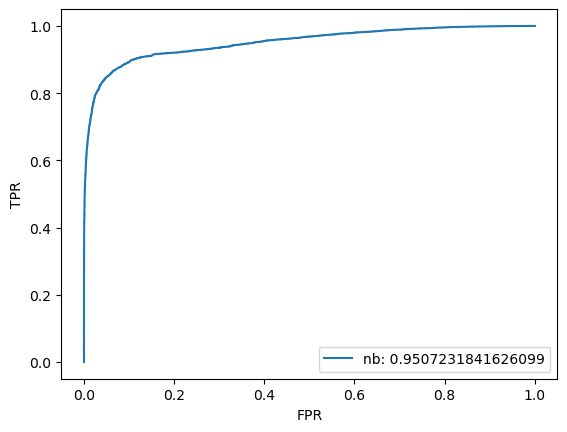

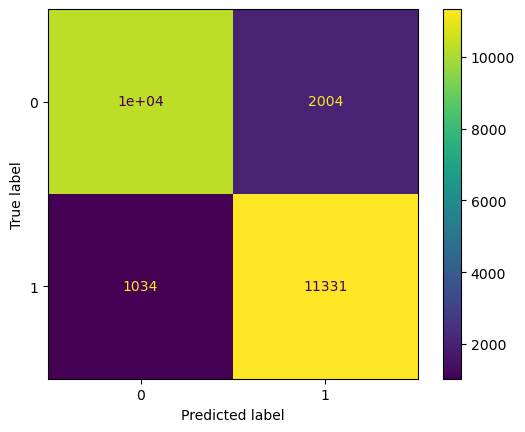

              precision    recall  f1-score   support

           0       0.91      0.84      0.87     12304
           1       0.85      0.92      0.88     12365

    accuracy                           0.88     24669
   macro avg       0.88      0.88      0.88     24669
weighted avg       0.88      0.88      0.88     24669



In [90]:
metrics_3 = evaluate(xtrain_3, ytrain_3, 3)

## Results

In [92]:
metrics_0_1 = pd.read_csv("C:/Users/Oamen/OneDrive/Documents/DATA PROJECTS/Project_Offensive_Hate_Speech_Detection/metrics_0_1.csv", index_col = [0])
metrics_0_1[:1]

,accuracy,precision,recall,f1,auc
nb_0,0.902885,0.917509,0.970481,0.94325,0.932528


In [93]:
results = pd.concat([metrics_0_1, metrics_2, metrics_3])
results

,accuracy,precision,recall,f1,auc
nb_0,0.902885,0.917509,0.970481,0.943250,0.932528
tree_0,0.896833,0.932209,0.944925,0.938337,0.829299
logreg_0,0.911898,0.920387,0.978730,0.948659,0.947918
forest_0,0.907526,0.918959,0.975657,0.946652,0.928332
adaboost_0,0.898648,0.904787,0.981399,0.941538,0.911125
knn_0,0.838052,0.841867,0.991508,0.910574,0.691745
xgboost_0,0.908400,0.913874,0.982450,0.946920,0.939535
nb_1,0.641575,0.595246,0.884594,0.711570,0.753155
forest_1,0.634773,0.573180,0.911342,0.698428,0.746669
xgboost_1,0.588660,0.831944,0.222454,0.350564,0.631805


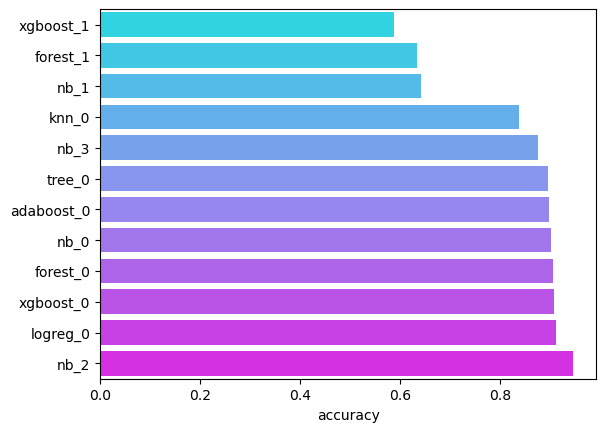

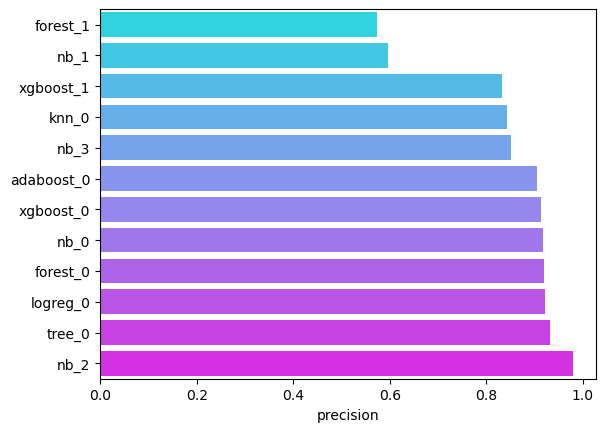

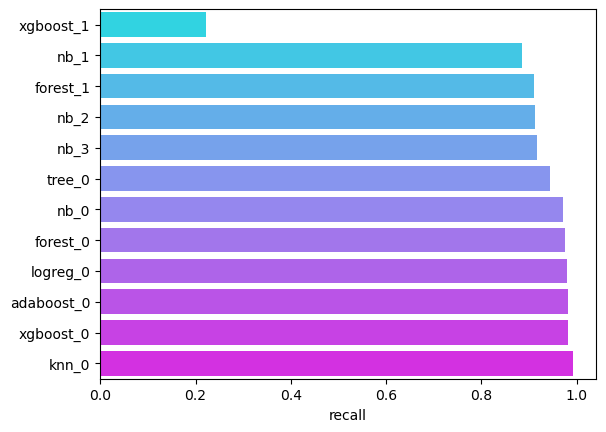

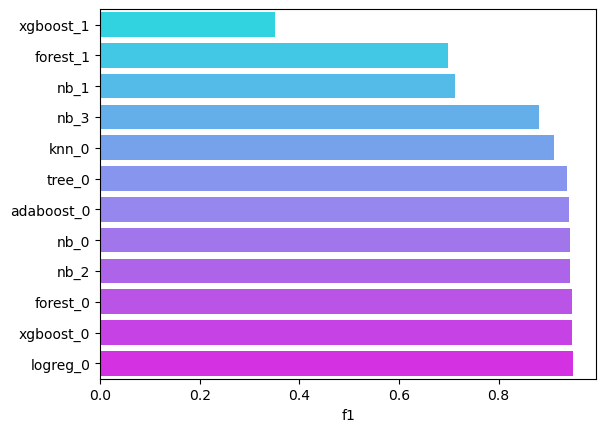

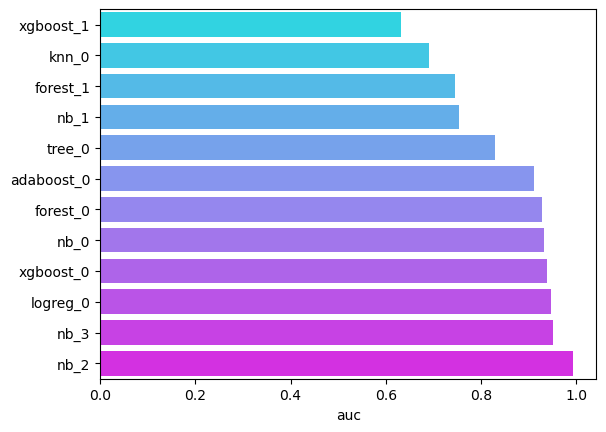

In [94]:
for metric in results.columns:
    
    plt.figure()
    
    sns.barplot(data = results.sort_values(by = metric), y = results.sort_values(by = metric).index, x = metric, palette = 'cool')

## Model & Preprocessor Training

In [15]:
xtrain, ytrain_c = RandomOverSampler().fit_resample(train['tweet'].values.reshape(-1, 1), ytrain)
xtrain = pd.DataFrame(xtrain, columns = ['tweet'])

xtrain[:1]

,tweet
0,RT @YoungDG_: Thats yo bitch she my bitch too


In [16]:
xtest = test[['tweet']]

In [17]:
xval = validation[['tweet']]

In [18]:
def placeholder_tokenize(text):
    
    text = text.lower()
    
    # replace all links with url
    text = re.sub(r"http[s]?://[\w\/\-\.\?]+", 'url', text)
    
    # replace hastags with the word after the hastag
    text = re.sub(r'#(\w+)', r'\1', text)
    
    # replace digits with numbers
    text = re.sub(r'\d+', 'num', text) 
    
    # replace punctuations
    punctuation_pattern = r'[!\"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~]'
    
    text = re.sub(punctuation_pattern, '', text)
    
    # replace @user with username
    text = re.sub(r'@\w+', 'username', text)
    

    # return words
    text = ' '.join([x for x in re.findall(r'\w+\s+', text)])
    
    return text

In [19]:
xtrain = pd.DataFrame([placeholder_tokenize(text) for text in xtrain['tweet']], columns = ['tweet'])

xtest = pd.DataFrame([placeholder_tokenize(text) for text in xtest['tweet']], columns = ['tweet'])

xval = pd.DataFrame([placeholder_tokenize(text) for text in xval['tweet']], columns = ['tweet'])

In [20]:
def stemm(text):
    
    stemmer = PorterStemmer()
    
    return ' '.join([stemmer.stem(word) for word in text.split()])

In [21]:
xtrains = pd.DataFrame([stemm(text) for text in xtrain['tweet']], columns = ['tweet'])

xtest = pd.DataFrame([stemm(text) for text in xtest['tweet']], columns = ['tweet'])

xval = pd.DataFrame([stemm(text) for text in xval['tweet']], columns = ['tweet'])

In [22]:
xtrains[:1]

,tweet
0,rt that yo bitch she my bitch


In [ ]:
# vectorizer = CountVectorizer(ngram_range = (2,3), stop_words = 'english')

In [38]:
# pipeline = Pipeline([
#     ('vectorizer', vectorizer)
# ])

In [39]:
# x_train = pipeline.fit_transform(xtrains['tweet'])

# #x_test = pipeline.transform(xtest['tweet'])

# #x_val = pipeline.transform(xval['tweet'])

In [40]:
# xtrain = pd.DataFrame(x_train.todense(), columns = pipeline.named_steps['vectorizer'].get_feature_names_out())

# #xtest = pd.DataFrame(x_test.todense(), columns = pipeline.named_steps['vectorizer'].get_feature_names_out())

# #xval = pd.DataFrame(x_val.todense(), columns = pipeline.named_steps['vectorizer'].get_feature_names_out())

## Hyperparameter Tuning

In [23]:
vectorizer = CountVectorizer(ngram_range = (2,3), stop_words = 'english')

model =  Pipeline([
    ('vectorizer', vectorizer),
    ('model', MultinomialNB())
])

In [24]:
param_grid = {
    'model__alpha': [0.2, 0.4, 1.0],
    'model__fit_prior':[True, False]
}

In [25]:
grid_search = GridSearchCV(model, param_grid, cv = 3, scoring = 'roc_auc').fit(xval['tweet'], yval)

print('Validation score:', grid_search.best_score_)

Validation score: 0.7777785487876455


In [27]:
grid_search.best_params_

{'model__alpha': 0.2, 'model__fit_prior': True}

## Train Evaluation

In [28]:
model =  Pipeline([
    ('vectorizer', vectorizer),
    ('model', MultinomialNB(alpha= 0.2, fit_prior = True))
])

In [30]:
model.fit(xtrain['tweet'], ytrain_c)

Pipeline(steps=[('vectorizer',
                 CountVectorizer(ngram_range=(2, 3), stop_words='english')),
                ('model', MultinomialNB(alpha=0.2))])

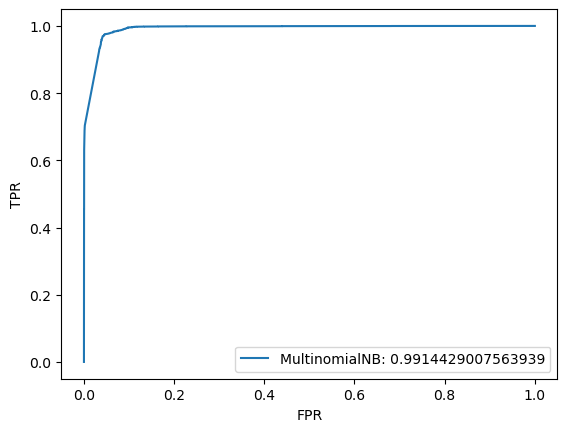

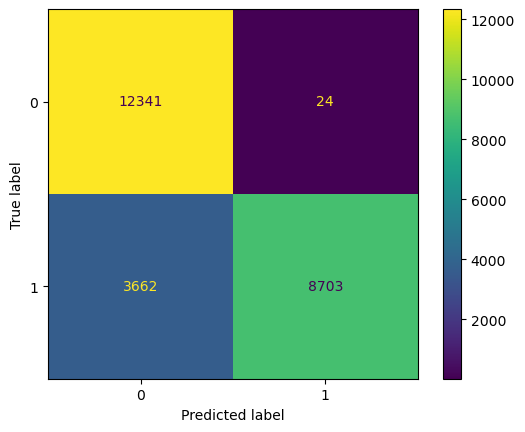

              precision    recall  f1-score   support

           0       0.77      1.00      0.87     12365
           1       1.00      0.70      0.83     12365

    accuracy                           0.85     24730
   macro avg       0.88      0.85      0.85     24730
weighted avg       0.88      0.85      0.85     24730



,accuracy,precision,recall,f1,auc
Train,0.85095,0.997278,0.703841,0.825212,0.991443


In [33]:
names, accuracy, precision, recall, f1, auc = [], [], [], [], [], []



accuracy.append(cross_val_score(model, xtrain['tweet'], ytrain_c, cv = 5, scoring = 'accuracy').mean())

precision.append(cross_val_score(model, xtrain['tweet'], ytrain_c, cv = 5, scoring = 'precision').mean())

recall.append(cross_val_score(model, xtrain['tweet'], ytrain_c, cv = 5, scoring = 'recall').mean())     

f1.append(cross_val_score(model, xtrain['tweet'], ytrain_c, cv = 5, scoring = 'f1').mean())

auc_ = cross_val_score(model, xtrain['tweet'], ytrain_c, cv = 5, scoring = 'roc_auc').mean()
auc.append(auc_)

ypred_proba = cross_val_predict(model, xtrain['tweet'], ytrain_c, cv = 5, method = 'predict_proba')



fpr, tpr, thresh = roc_curve(ytrain_c, ypred_proba[:, 1])

plt.plot(fpr, tpr, label = f'MultinomialNB: {auc_}');plt.xlabel('FPR'); plt.ylabel('TPR'); plt.legend();plt.show();

ypred_class = cross_val_predict(model, xtrain['tweet'], ytrain_c, cv = 5)
cm = confusion_matrix(ytrain_c, ypred_class)
ConfusionMatrixDisplay(cm).plot(); plt.show();

print(classification_report(ytrain_c, ypred_class))

pd.DataFrame({
    'accuracy':accuracy,
    'precision':precision,
    'recall':recall,
    'f1':f1,
    'auc':auc,
}, index = ['Train'])

## Testing

In [34]:
test_pred = model.predict(xtest['tweet'])

test_proba = model.predict_proba(xtest['tweet'])

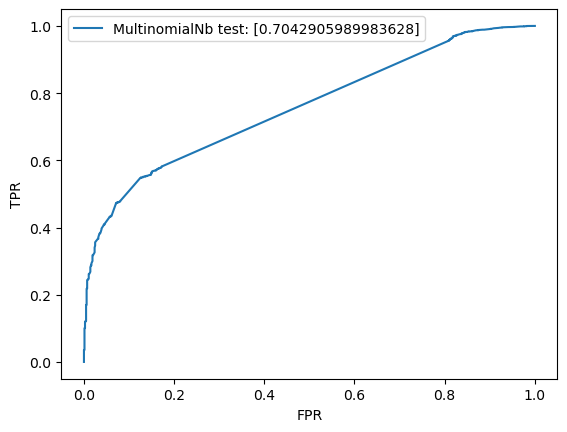

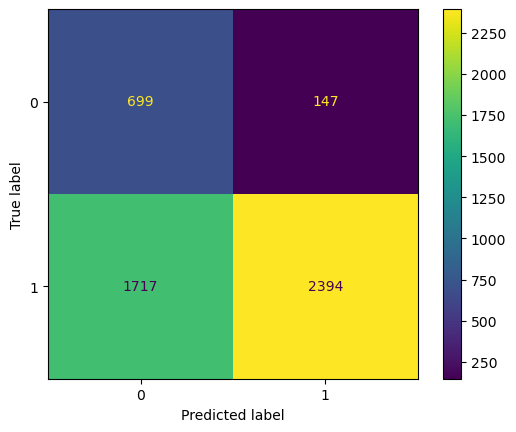

              precision    recall  f1-score   support

           0       0.29      0.83      0.43       846
           1       0.94      0.58      0.72      4111

    accuracy                           0.62      4957
   macro avg       0.62      0.70      0.57      4957
weighted avg       0.83      0.62      0.67      4957



,accuracy,precision,recall,f1,auc
Test,0.623966,0.942149,0.58234,0.719784,0.704291


In [36]:
names, accuracy, precision, recall, f1, auc = [], [], [], [], [], []


accuracy.append(accuracy_score(ytest,test_pred))

precision.append(precision_score(ytest,test_pred))

recall.append(recall_score(ytest,test_pred))

f1.append(f1_score(ytest,test_pred))

auc.append(roc_auc_score(ytest,test_pred))


fpr, tpr, thresh = roc_curve(ytest, test_proba[:, 1])

plt.plot(fpr, tpr, label = f'MultinomialNb test: {auc}');plt.xlabel('FPR'); plt.ylabel('TPR'); plt.legend();plt.show();

cm = confusion_matrix(ytest, test_pred)
ConfusionMatrixDisplay(cm).plot(); plt.show();

print(classification_report(ytest, test_pred))

pd.DataFrame({
    'accuracy':accuracy,
    'precision':precision,
    'recall':recall,
    'f1':f1,
    'auc':auc,
}, index = ['Test'])

## Saving Model

In [37]:
filename = 'Hate_and_Offensive_speech_model.pkl'

joblib.dump(model, filename)

['Hate_and_Offensive_speech_model.pkl']

## Testing Model on Recent Tweets and comments

This sample was gotten off Twitter posts and articles.
Source:  https://blog.ongig.com/diversity-and-inclusion/human-rights-policy-hate-speech-policy/

In [38]:
loaded_model = joblib.load(filename)

In [39]:
import re
from nltk.stem import PorterStemmer

def preprocess_text(text):
    
    
    text = text.lower()
    
    # replace all links with url
    text = re.sub(r"http[s]?://[\w\/\-\.\?]+", 'url', text)
    
    # replace hastags with the word after the hastag
    text = re.sub(r'#(\w+)', r'\1', text)
    
    # replace digits with numbers
    text = re.sub(r'\d+', 'num', text) 
    
    # replace punctuations
    punctuation_pattern = r'[!\"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~]'
    
    text = re.sub(punctuation_pattern, '', text)
    
    # replace @user with username
    text = re.sub(r'@\w+', 'username', text)
    

    # return words
    text = ' '.join([x for x in re.findall(r'\w+\s+', text)])
        
    stemmer = PorterStemmer()
    
    value =  ' '.join([stemmer.stem(word) for word in text.split()])
    
    df = pd.DataFrame(value, index = [0], columns = ['tweet'])
    
    return df

In [43]:
def evaluate(data):
    
    x = preprocess_text(data)
        
    if model.predict(x['tweet']) == 0:
        
        print('No Hate speech or offensive detected')
        
    else:
            
        print('Hate speech or offensive speech detected')

In [47]:
new_data_1 = """This is a class from Harvard University:

"Introduction to Data Science with Python."

You can take this class for free. If you want the certificate, you can pay $299 for it.

You should be familiar with Python to take this course.

The course is for beginners. It's for those who want to build a fundamental understanding of machine learning and artificial intelligence.

The course will cover some of these topics:

• Generalization and overfitting
• Model building, regularization, and evaluation
• Linear and logistic regression models
• k-Nearest Neighbor
• Scikit-Learn, NumPy, Pandas, and Matplotlib

This course is perfect if you are a software developer with experience writing Python code and want to start with Machine Learning.

Link: pll.harvard.edu/course/introdu…."""

In [48]:
evaluate(new_data_1)

No Hate speech or offensive detected


In [49]:
new_data_2 = """I don't disrespect people here. Please, don't come to my tweet and say, "rest".

If you don't like my tweets or football bants, you can mute or block me.

Ko si ja church."""

In [50]:
evaluate(new_data_2)

Hate speec or offensive speech detected


In [51]:
new_data_3 = """Honestly there's no sense telling anyone to go back to their village

Traveled by road from Kogi to Ibadan two days ago and omo☹️

No offense to people from Ekiti, but what the actual fvck is going on in ur state?

All the politicians in that state should be stoned to death"""

In [52]:
evaluate(new_data_3)

No Hate speech or offensive detected


In [53]:
new_data_4 = """Let’s Kill Jews, and let’s kill them for fun. #killjews"""

In [54]:
evaluate(new_data_4)

Hate speec or offensive speech detected


In [57]:
new_data_5 = """The Palestinians are like crocodiles; the more you give them meat, they want more"""

In [58]:
evaluate(new_data_5)

Hate speec or offensive speech detected
